# Blog 1: Reading and Displaying Images in OpenCV

# Content:

1. Importing Libraries<br>
2. Loading Images using cv2 <br>
    - 2.1 Loading using cv2
    - 2.2 Viewing pixels for an image
    - 2.3 Looking at (b,g,r), (l,u,v) (h,s,v) (h,l,s) layers
3. cv2.Convert Images from BGR to Others
4. parameters in plt.imshow()
    - cmap
    - interpolation
    - vmin,max
    - alpha
    - origin

## 1. Import Libraries

important libraries to work with images in python are 
- **opencv**, imported as cv2
- **PIL**, Image fucntions for creating [refernce](https://pillow.readthedocs.io/en/3.1.x/reference/Image.htmlv), 
- **Numpy**, to manage numpy arrays in images
- **matplotlib.pyplot** - used for ploting images in the Notebook

references:



In [2]:
# importing open cv 
import cv2
# importing matplotlib pyplot to plot images
import matplotlib.pyplot as plt
%matplotlib inline 
import matplotlib
#importing numpy to create numpy arrays
import numpy as np
#PIL Image, functions to create new images
from PIL import Image

## 2. Loading Images using OpenCV
### 2.1 Loading using cv2

In [74]:
images = []
heading = []

In [75]:
# by default the images gets loaded in b,g,r format
images.append(cv2.imread("assets/ayu.png"))
heading.append("default-bgr")
#image path with 0 is used to load in gray scale
images.append(cv2.imread("assets/ayu.png",0))
heading.append("grey scale-0")
#1 is used to mensiotn read in color
images.append(cv2.imread("assets/ayu.png",1))
heading.append("bgr-1")
# -1 means unchanged but gets loaded in BGR format
images.append(cv2.imread("assets/ayu.png",-1))
heading.append("unchanged- -1")
#Reading in color format (default color format is BGR)
images.append(cv2.imread("assets/ayu.png",cv2.IMREAD_COLOR))
heading.append("cv2.IMREAD_COLOR")
# reading in gray scale
images.append(cv2.imread("assets/ayu.png",cv2.IMREAD_GRAYSCALE))
heading.append("cv2.IMREAD_GRAYSCALE")
#reading in unchanged manner (default unchanged format is BGR)
images.append(cv2.imread("assets/ayu.png",cv2.IMREAD_UNCHANGED))
heading.append("cv2.IMREAD_UNCHANGED")
# any other positive integer is color(BGR)
images.append(cv2.imread("assets/ayu.png",3))
heading.append("unchanged - 3")

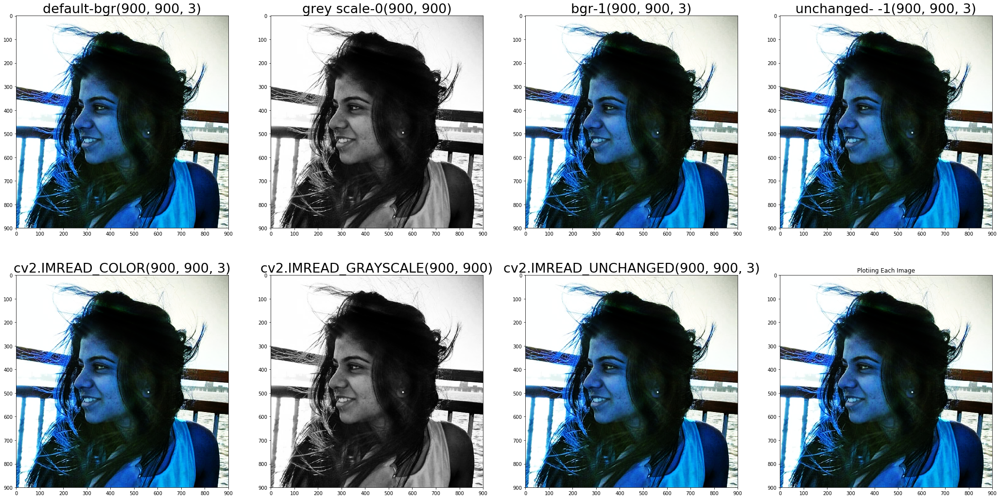

In [80]:
fig = plt.figure(figsize = (36, 18)) 

#Ploting image using 
for i in range(len(images)):
    ax = fig.add_subplot(2, len(images)/2, i + 1)
    ax.imshow(images[i],cmap='gray')
    ax.set_title(heading[i] + str(images[i].shape),fontsize=27)   

### 2.2 Viewing pixels

In [68]:
#importing image in gray scale
img = cv2.imread("assets/ayu_s.png",0)

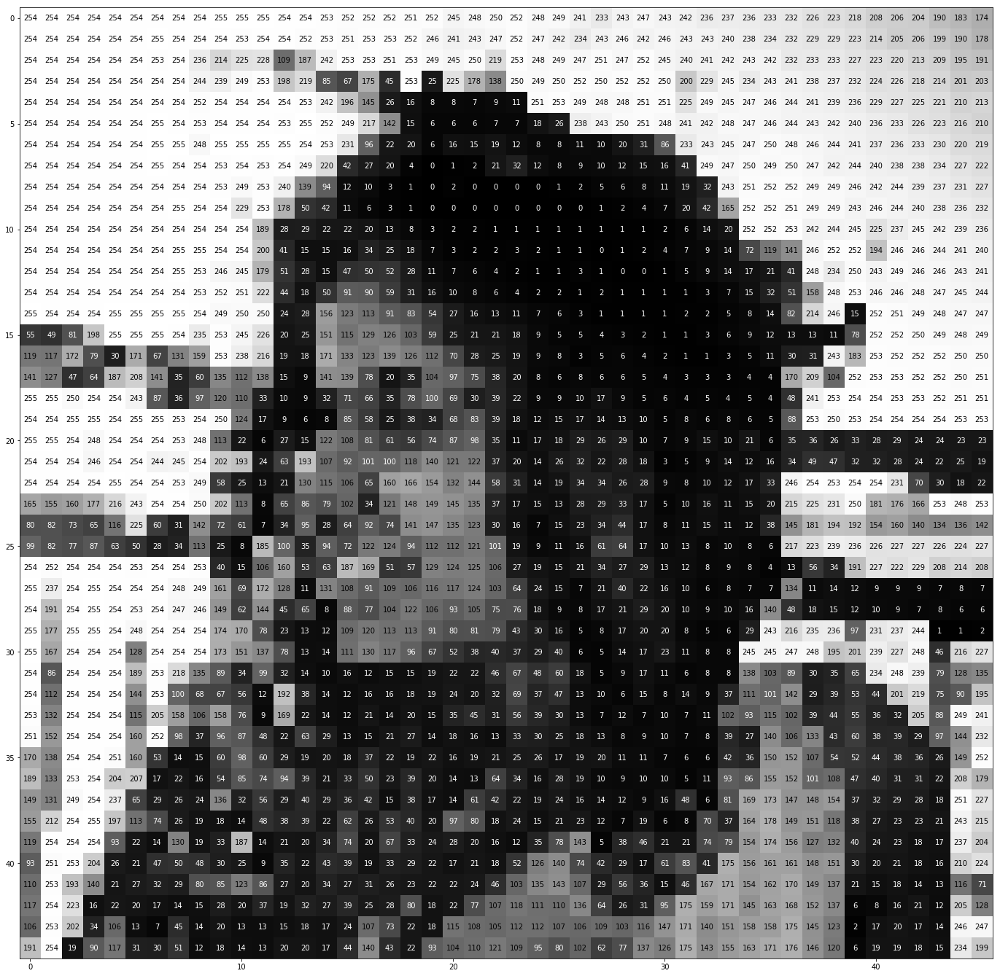

In [70]:
#plotting each pixel with gray scale value
fig = plt.figure(figsize = (24,24)) 
ax = fig.add_subplot(111)
ax.imshow(img, cmap='gray')
width, height = img.shape
thresh = img.max()/2.5
for x in range(width):
    for y in range(height):
        val = round(img[x][y],2) if img[x][y] !=0 else 0
        ax.annotate(str(val), xy=(y,x),
                    horizontalalignment='center',
                    verticalalignment='center',
                    color='white' if img[x][y]<thresh else 'black')

In [5]:
print(images[0].dtype)
print(type(images[0]))
print("Default, bgr, unchanged:",images[0].shape)
print("grayscale, 0:",images[1].shape)

uint8
<class 'numpy.ndarray'>
Default, bgr, unchanged: (900, 900, 3)
grayscale, 0: (900, 900)


Accessing Blue, Green and Red in bgr format
0 - Blue
1 - Green
2- Red


In [6]:
# print blue pixels
images[0][400:404,400:404,0]

array([[27, 26, 24, 22],
       [28, 28, 26, 24],
       [26, 26, 25, 24],
       [26, 26, 26, 25]], dtype=uint8)

In [7]:
# print green pixels
images[0][400:404,400:404,1]

array([[64, 65, 64, 63],
       [69, 68, 67, 65],
       [66, 68, 65, 63],
       [67, 68, 67, 64]], dtype=uint8)

In [8]:
# print red pixels
images[0][400:404,400:404,2]

array([[109, 111, 113, 113],
       [117, 117, 117, 117],
       [123, 122, 119, 116],
       [125, 125, 119, 117]], dtype=uint8)

### 2.3 Looking at B,G,R Layers
b,g,r = cv2.split(img)<br>
np_zeros = np.zeros(b.shape)<br>
img_b = cv2.merge((b,np_zeros,np_zeros))<br>
img_g = cv2.merge((np_zeros,g,np_zeros))<br>
img_r = cv2.merge((np_zeros,np_zeros,r))

In [9]:
#convert to red
img_b = images[0].copy()
img_b[:,:,1] = 0
img_b[:,:,2] = 0

img_g = images[0].copy()
img_g[:,:,0] = 0
img_g[:,:,2] = 0

img_r = images[0].copy()
img_r[:,:,0] = 0
img_r[:,:,1] = 0

img_list = [img_b,img_g,img_r]

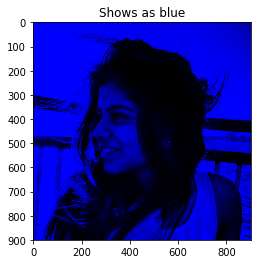

In [10]:
plt.imshow(img_r)
plt.title("Shows as blue")
cv2.imshow('Shows red',img_r)
cv2.waitKey(0)
cv2.destroyAllWindows()

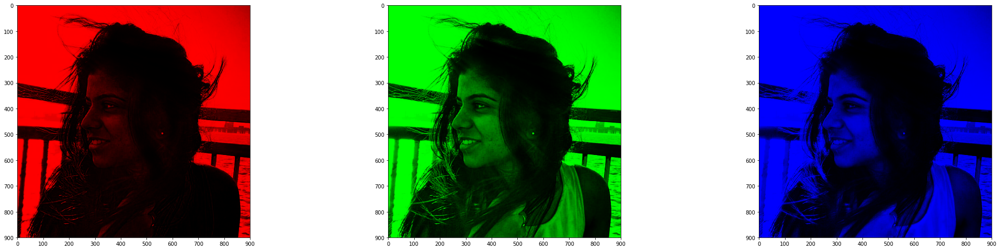

In [11]:
fig = plt.figure(figsize = (36, 22)) 

for i in range(len(img_list)):
    ax = fig.add_subplot(1, 3, i + 1)
    ax.imshow(img_list[i])
    #

### 2.4 Looking at HSV layers
bgr to hsv (hue, saturation and value)<br>
HSV color space is consists of 3 matrices, 'hue', 'saturation' and 'value'. In OpenCV, value range for 'hue', 'saturation' and 'value' are respectively 0-179, 0-255 and 0-255. 'Hue' represents the color, 'saturation' represents the amount to which that respective color is mixed with white and 'value' represents the amount to which that respective color is mixed with black.

<img src = "assets/hsv_math.png">

> **Note** To know the mathematical conversion check out the following link:
https://docs.opencv.org/3.3.0/de/d25/imgproc_color_conversions.html


In [ ]:
plt.figure(figsize = (36, 9)) 
hsv = cv2.cvtColor(images[0], cv2.COLOR_BGR2HSV)
h,s,v = cv2.split(hsv)
hsv_split = np.concatenate((h,s,v),axis = 1) 
img_bgr = Image.fromarray(hsv_split)
print(img_bgr.size)
plt.imshow(img_bgr)

### 2.4 Looking at HLS layers

(2700, 900)


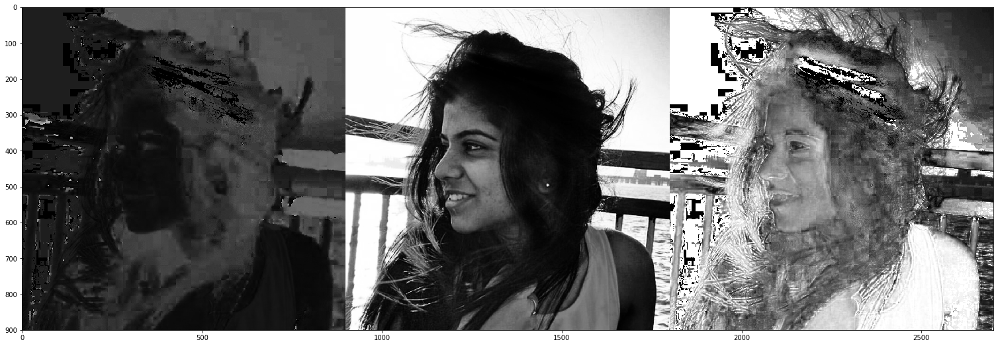

In [13]:
plt.figure(figsize = (36, 9)) 
hls = cv2.cvtColor(images[0], cv2.COLOR_BGR2HLS)
h,l,s = cv2.split(hls)
hls_split = np.concatenate((h,l,s),axis = 1) 
img_bgr = Image.fromarray(hls_split)
print(img_bgr.size)
plt.imshow(img_bgr)

### 2.4 Looking at LUV layers

(2700, 900)


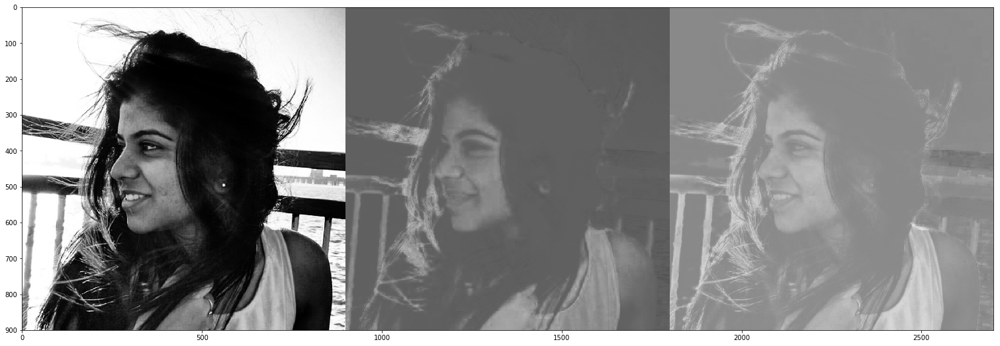

In [14]:
plt.figure(figsize = (36, 9)) 
luv = cv2.cvtColor(images[0], cv2.COLOR_BGR2LUV)
l,u,v = cv2.split(luv)
luv_split = np.concatenate((l,u,v),axis = 1) 
img_bgr = Image.fromarray(luv_split)
print(img_bgr.size)
plt.imshow(img_bgr)

## 3. "cv2.cvtColor" attributes from BGR to Others

Images 

In [16]:
import cv2
# getting all the attributes to convert from BGR2
flags = [i for i in dir(cv2) if i.startswith('COLOR_BGR2')]
flags = [str("cv2."+ fl) for fl in flags]
print(flags)
print(len(flags))


['cv2.COLOR_BGR2BGR555', 'cv2.COLOR_BGR2BGR565', 'cv2.COLOR_BGR2BGRA', 'cv2.COLOR_BGR2GRAY', 'cv2.COLOR_BGR2HLS', 'cv2.COLOR_BGR2HLS_FULL', 'cv2.COLOR_BGR2HSV', 'cv2.COLOR_BGR2HSV_FULL', 'cv2.COLOR_BGR2LAB', 'cv2.COLOR_BGR2LUV', 'cv2.COLOR_BGR2Lab', 'cv2.COLOR_BGR2Luv', 'cv2.COLOR_BGR2RGB', 'cv2.COLOR_BGR2RGBA', 'cv2.COLOR_BGR2XYZ', 'cv2.COLOR_BGR2YCR_CB', 'cv2.COLOR_BGR2YCrCb', 'cv2.COLOR_BGR2YUV', 'cv2.COLOR_BGR2YUV_I420', 'cv2.COLOR_BGR2YUV_IYUV', 'cv2.COLOR_BGR2YUV_YV12']
21


In [17]:
cv2.COLOR_BGR2BGR555

22

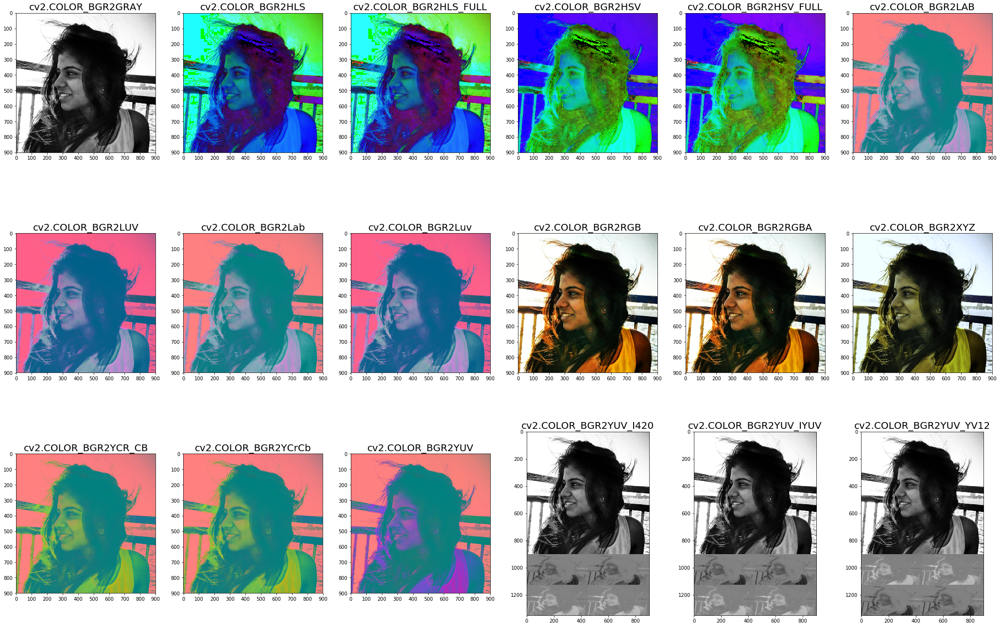

In [18]:
#https://stackoverflow.com/questions/9437726/how-to-get-the-value-of-a-variable-given-its-name-in-a-string
fig = plt.figure(figsize = (36, 32)) 
for i in range(3,len(flags)):
    ax = fig.add_subplot(4, 6, i -2)
    ax.imshow(cv2.cvtColor(images[0],eval(flags[i])),cmap = 'gray')
    ax.set_title(flags[i],fontsize=20)

### 2. plt.imshow() parameters
### cmap
https://matplotlib.org/3.1.0/tutorials/colors/colormaps.html <br>
https://matplotlib.org/examples/color/colormaps_reference.html <br>
https://matplotlib.org/3.1.1/api/_as_gen/matplotlib.pyplot.imshow.html

In [21]:
per_uni_seq = ['viridis', 'plasma', 'inferno', 'magma']
seq_colormaps = ['Greys','Purples','Blues','Greens','Oranges','Reds','YlOrBr','YlOrRd','OrRd','PuRd']
seq2_colormaps = ['binary','gray','pink','summer','autumn','winter','cool','Wistia','copper','afmhot']
div_colormaps = ['PiYG', 'PRGn', 'BrBG', 'PuOr', 'RdGy', 'RdBu','RdYlBu', 'RdYlGn', 'Spectral', 'coolwarm', 'bwr', 'seismic']
qual_colormaps = ['Pastel1','Pastel2','Paired','Accent','Dark2','Set1','Set2','Set3','tab10','tab20','tab20b','tab20c']
mis_colormaps = ['flag', 'prism', 'ocean', 'gist_earth', 'terrain', 'gist_stern',
            'gnuplot', 'gnuplot2', 'CMRmap', 'cubehelix', 'brg', 'hsv',
            'gist_rainbow', 'rainbow', 'jet', 'nipy_spectral', 'gist_ncar']

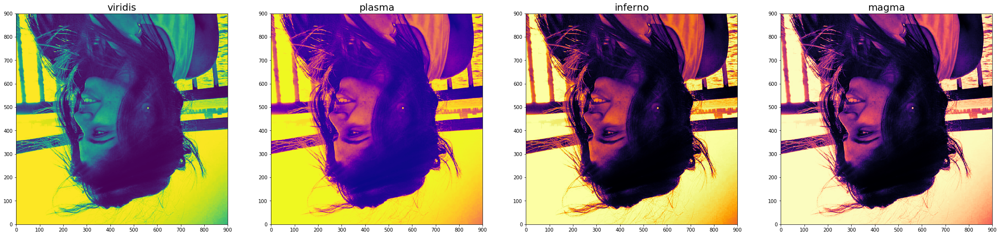

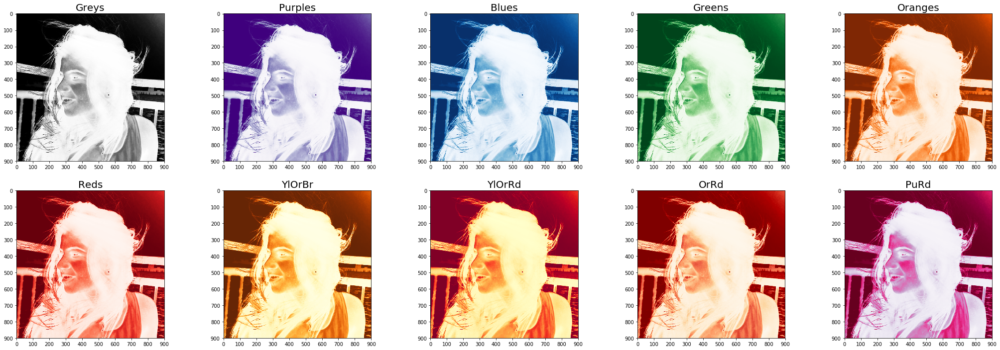

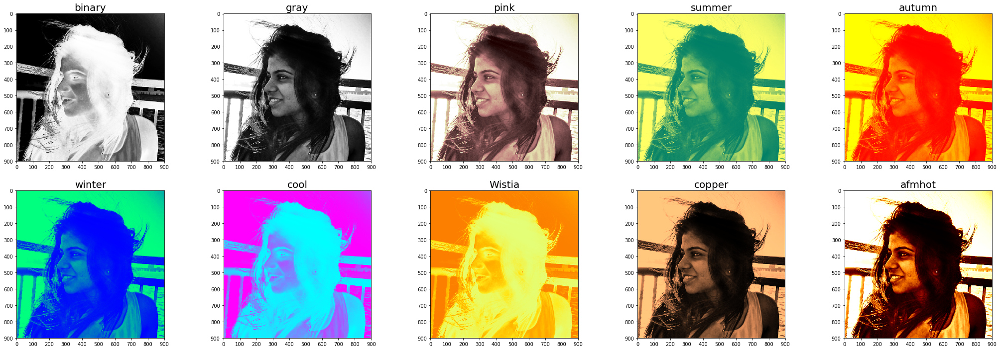

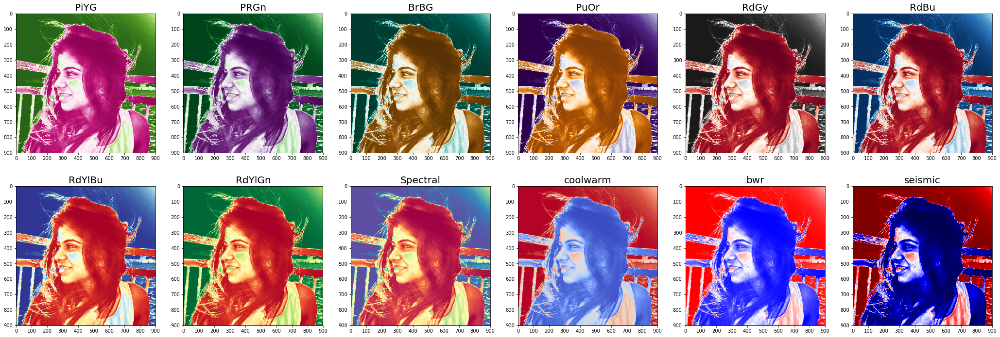

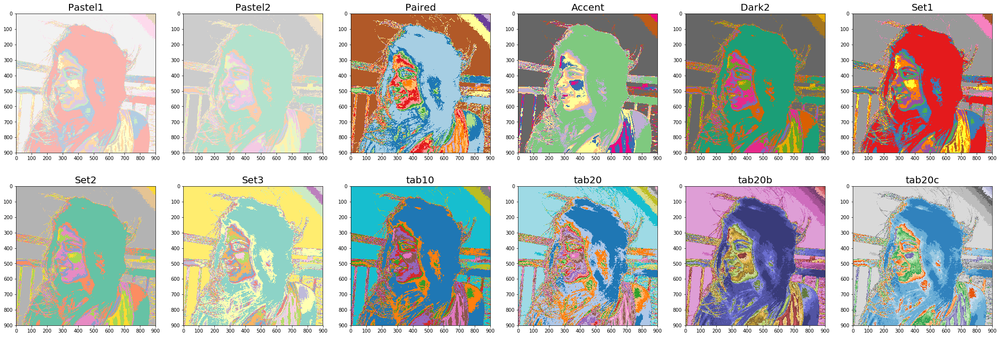

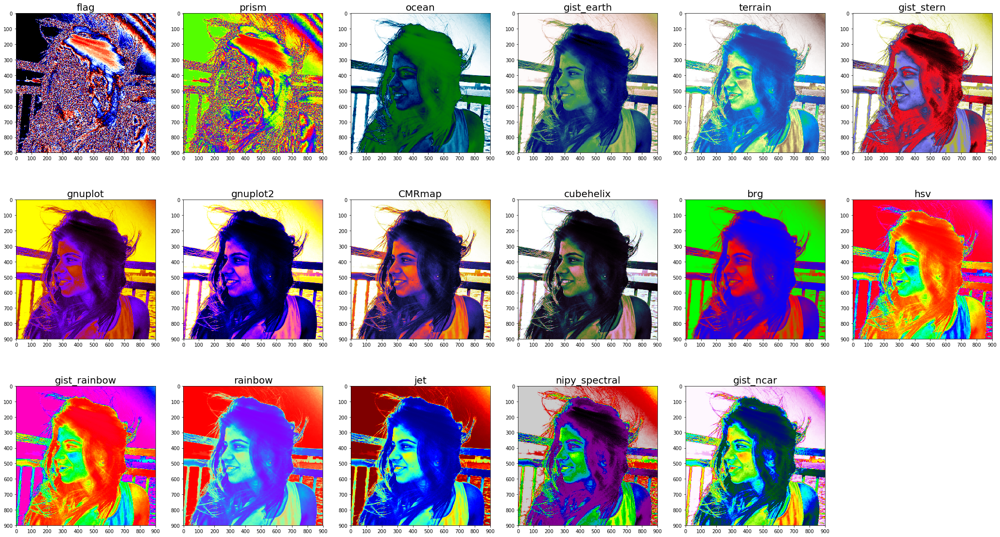

In [24]:
img = cv2.cvtColor(images[0],cv2.COLOR_BGR2GRAY)

fig = plt.figure(figsize = (36,8)) 
for i,cmap in enumerate(per_uni_seq):
    ax = fig.add_subplot(1, 4, i+1)
    ax.imshow(img, cmap = cmap,aspect = 'equal' , origin = 'lower')
    ax.set_title(per_uni_seq[i],fontsize=27)
    #auto

fig = plt.figure(figsize = (36,12)) 
for i,cmap in enumerate(seq_colormaps):
    ax = fig.add_subplot(2, 5, i+1)
    ax.imshow(img, cmap = cmap)
    ax.set_title(seq_colormaps[i],fontsize=27)

fig = plt.figure(figsize = (36,12))
for i,cmap in enumerate(seq2_colormaps):
    ax = fig.add_subplot(2, 5, i+1)
    ax.imshow(img, cmap = cmap)
    ax.set_title(seq2_colormaps[i],fontsize=27)

fig = plt.figure(figsize = (36,12))
for i,cmap in enumerate(div_colormaps):
    ax = fig.add_subplot(2, 6, i+1)
    ax.imshow(img, cmap = cmap)
    ax.set_title(div_colormaps[i],fontsize=27)
    
fig = plt.figure(figsize = (36,12))
for i,cmap in enumerate(qual_colormaps):
    ax = fig.add_subplot(2, 6, i+1)
    ax.imshow(img, cmap = cmap)
    ax.set_title(qual_colormaps[i],fontsize=27)
    
    
fig = plt.figure(figsize = (36,20))
for i,cmap in enumerate(mis_colormaps):
    ax = fig.add_subplot(3, 6, i+1)
    ax.imshow(img, cmap = cmap)
    ax.set_title(mis_colormaps[i],fontsize=27)

### interpolation

In [25]:
img = cv2.imread("assets/ayu_s.png",0)

In [26]:
inter_list = ['nearest', 'bilinear', 'bicubic', 'spline16', 'spline36', 'hanning', 'hamming', 'hermite', 'kaiser', 'quadric', 'catrom', 'gaussian', 'bessel', 'mitchell', 'sinc', 'lanczos']

In [27]:
len(inter_list)

16

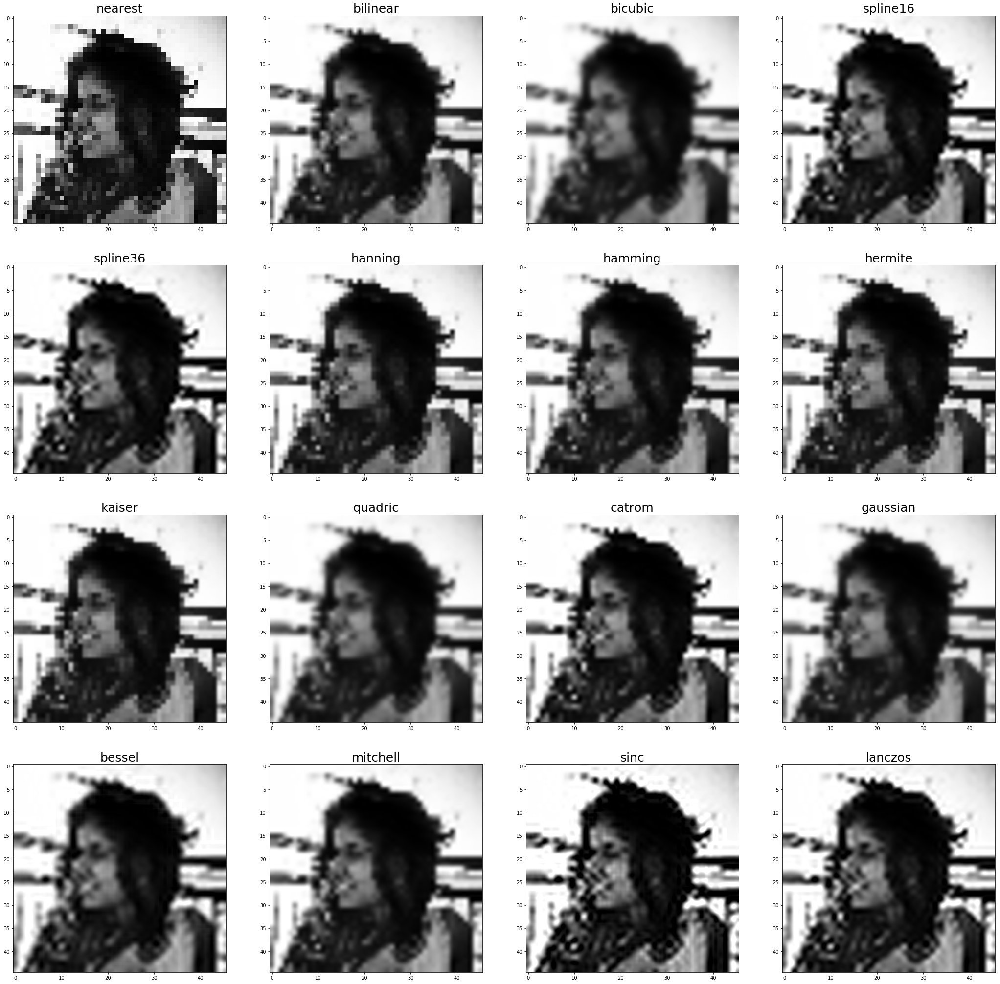

In [28]:
fig = plt.figure(figsize = (36,36))
for i,inter in enumerate(inter_list):
    ax = fig.add_subplot(4, 4, i+1)
    ax.imshow(img, cmap = 'gray', interpolation = inter)
    ax.set_title(inter_list[i],fontsize=25)

### alpha

In [43]:
alpha = np.linspace(0,1,10)

In [44]:
img = cv2.imread("assets/ayu.png",0)

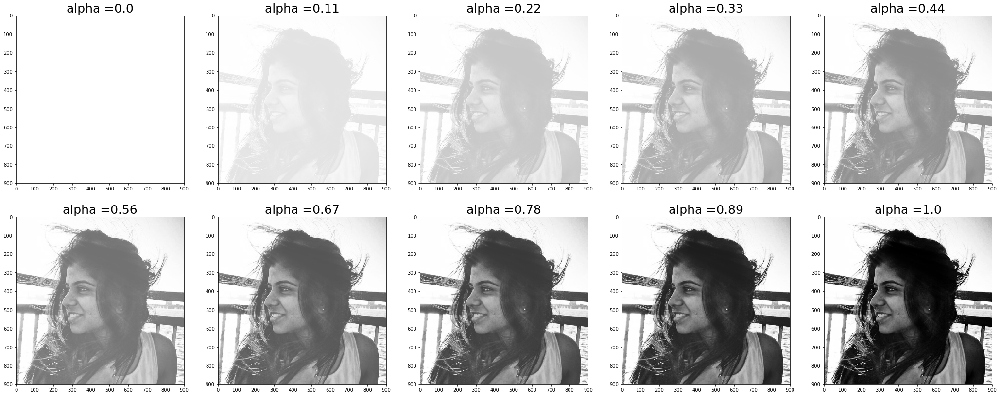

In [54]:
fig = plt.figure(figsize = (36,14))
for i,alph in enumerate(alpha):
    ax = fig.add_subplot(2, 5, i+1)
    ax.imshow(img, cmap = 'gray', alpha = alph)
    ax.set_title("alpha ={}".format(np.round(alph,2)),fontsize=25)

### vmin and vmax

In [57]:
vinmax_min = [(x,x+50) for x in range(0,201,50)]

In [58]:
vinmax_min

[(0, 50), (50, 100), (100, 150), (150, 200), (200, 250)]

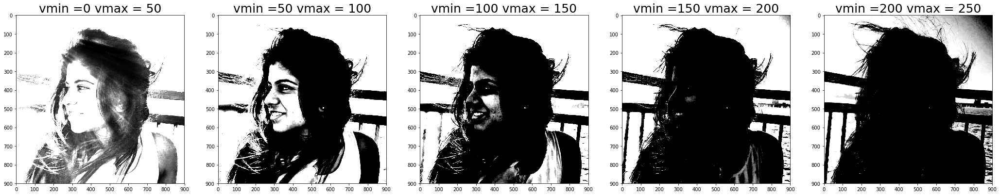

In [64]:
fig = plt.figure(figsize = (36,9))
for i,vmi in enumerate(vinmax_min):
    vmi,vma = vmi
    ax = fig.add_subplot(1, 5, i+1)
    ax.imshow(img, cmap = 'gray', vmin = vmi,vmax = vma)
    ax.set_title("vmin ={} vmax = {}".format(vmi,vma),fontsize=25)

### origin :

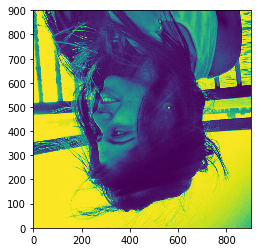

In [67]:
plt.imshow(img,origin = 'lower') #or upper